<a href="https://colab.research.google.com/github/hany606/Drone-Detection/blob/main/training_scripts/Detectron2_Faster_RCNN_C4_ICV2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Faster-RCNN (Training script)

## faster_rcnn_R_101_C4_3x

https://github.com/facebookresearch/detectron2/blob/main/configs/COCO-Detection/faster_rcnn_R_101_C4_3x.yaml

# Install Detectron2 Dependencies

In [ ]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
     |████████████████████████████████| 703.8 MB 22 kB/s 
     |████████████████████████████████| 6.6 MB 43.8 MB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.9.0+cu102
    Uninstalling torch-1.9.0+cu102:
      Successfully uninstalled torch-1.9.0+cu102
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.10.0+cu102
    Uninstalling torchvision-0.10.0+cu102:
      Successfully uninstalled torchvision-0.10.0+cu102
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.10.0 requires torch==1.9.0, but you have torch 1.5.0+cu101 which is incompatible.
     |████████████████████████████████| 274 kB 7.5 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=d8cafd7c16eb5d195435e8cffc2727

In [ ]:
# install detectron2:
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html
     |████████████████████████████████| 6.2 MB 4.2 MB/s 
     |████████████████████████████████| 49 kB 3.6 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20210924-py3-none-any.whl size=60829 sha256=2558f4c8a26d9eb21d1ff7e6ed075f86935d5ddd8125af6d32a02e27f043e893
  Stored in directory: /root/.cache/pip/wheels/70/c6/de/aa41c65141bdbc9a8aa4b303ce26482aa2f1720ff41b7f17c3
Successfully built fvcore


In [ ]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

# Import and Register Custom Detectron2 Data

In [ ]:
# Training on source
!curl -L "https://app.roboflow.com/ds/1TvYiUygrb?key=UiZvCVVceY" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip
# Training on target
# !curl -L "https://app.roboflow.com/ds/KmEN3iTY2U?key=CxGIpBdaDO" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   879  100   879    0     0   1101      0 --:--:-- --:--:-- --:--:--  1101
100 15.0M  100 15.0M    0     0  11.5M      0  0:00:01  0:00:01 --:--:-- 51.2M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/101_JPEG.rf.f257376fd84f05213e2d04de37253f28.jpg  
 extracting: test/10_JPEG.rf.962bd3624c92a4b7b4e608c478d6e23e.jpg  
 extracting: test/110_JPEG.rf.0d582bf8cd5f70573593408bed3c9338.jpg  
 extracting: test/111_JPEG.rf.870a4804cbe743cfdeca8b086a8288c5.jpg  
 extracting: test/113_JPEG.rf.fbf03b95a0379d88d4dc4c6b77a5570a.jpg  
 extracting: test/119_JPEG.rf.223d33e1a2736c3bf949ba2f1a04e008.jpg  
 extracting: test/11_JPEG.rf.04ba703376274d42d21d07f999fdb297.jpg  
 extracting: test/137_JPEG.rf.bad689d562011fffa9366be3ded3941b.jpg  
 extracting: tes

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")


WARNING [10/06 03:06:41 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[10/06 03:06:41 d2.data.datasets.coco]: Loaded 223 images in COCO format from /content/train/_annotations.coco.json
(416, 416, 3)


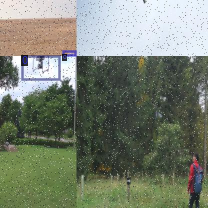

(416, 416, 3)


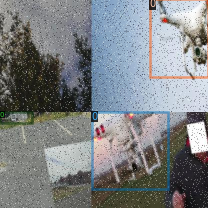

(416, 416, 3)


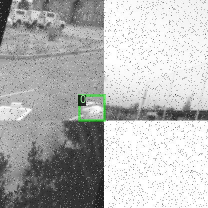

In [ ]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    print(img.shape)
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

### Target dataset

In [ ]:
!mkdir data2
# Evaluation on target
!curl -L "https://app.roboflow.com/ds/KmEN3iTY2U?key=CxGIpBdaDO" > roboflow2.zip; unzip -d data2 roboflow2.zip; rm roboflow2.zip
# Evaluation on source
# !curl -L "https://app.roboflow.com/ds/1TvYiUygrb?key=UiZvCVVceY" > roboflow2.zip; unzip -d data2 roboflow2.zip; rm roboflow2.zip

mkdir: cannot create directory ‘data2’: File exists
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   879  100   879    0     0   1248      0 --:--:-- --:--:-- --:--:--  1248
100 29.9M  100 29.9M    0     0  29.7M      0  0:00:01  0:00:01 --:--:-- 29.7M
Archive:  roboflow2.zip
 extracting: data2/README.dataset.txt  
 extracting: data2/README.roboflow.txt  
   creating: data2/test/
 extracting: data2/test/_annotations.coco.json  
 extracting: data2/test/name10_JPEG.rf.289d5aad229aab527bbf4b63cb8a4bf4.jpg  
 extracting: data2/test/name11_JPEG.rf.4f10e8f58716a4635cb3355609155b34.jpg  
 extracting: data2/test/name13_JPEG.rf.a9058e07faa966703747a3c297c10c07.jpg  
 extracting: data2/test/name18_JPEG.rf.353ffce757497655a5514514726d9d02.jpg  
 extracting: data2/test/name20_JPEG.rf.273d1c99864f9c1b522e7e3d1df4d35b.jpg  
 extracting: data2/test/name21_JPEG.rf.0a160ee3a88ca791f886093c

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("target_dataset_train", {}, "/content/data2/train/_annotations.coco.json", "/content/data2/train")
register_coco_instances("target_dataset_val", {}, "/content/data2/valid/_annotations.coco.json", "/content/data2/valid")
register_coco_instances("target_dataset_test", {}, "/content/data2/test/_annotations.coco.json", "/content/data2/test")

WARNING [10/06 05:25:03 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[10/06 05:25:03 d2.data.datasets.coco]: Loaded 700 images in COCO format from /content/data2/train/_annotations.coco.json
(416, 416, 3)


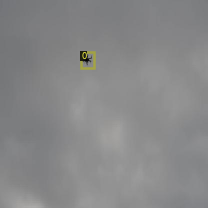

(416, 416, 3)


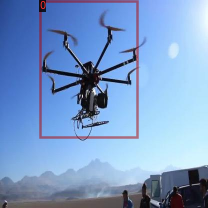

(416, 416, 3)


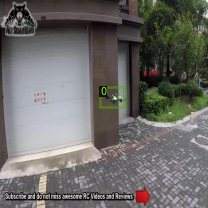

In [ ]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("target_dataset_train")
dataset_dicts = DatasetCatalog.get("target_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    print(img.shape)
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Train Custom Detectron2 Detector

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [ ]:
#from .detectron2.tools.train_net import Trainer
#from detectron2.engine import DefaultTrainer
# select from modelzoo here: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md#coco-object-detection-baselines
# Configuration guide: https://detectron2.readthedocs.io/en/latest/modules/config.html

from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_C4_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_101_C4_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001


cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 2000 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (1000, 1500) # The iteration number to decrease learning rate by GAMMA
cfg.SOLVER.GAMMA = 0.05




cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64  # number of proposals to sample for training
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2 #your number of classes + 1

cfg.TEST.EVAL_PERIOD = 500


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[10/06 04:27:55 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): ResNet(
    (stem): BasicStem(
      (conv1): Conv2d(
        3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
        (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
      )
    )
    (res2): Sequential(
      (0): BottleneckBlock(
        (shortcut): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
        )
        (conv1): Conv2d(
          64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv2): Conv2d(
          64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv3): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
 

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 2048) in the checkpoint but (3, 2048) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (3,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 2048) in the checkpoint but (8, 2048) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (8,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, we

[10/06 04:27:55 d2.engine.train_loop]: Starting training from iteration 0
[10/06 04:28:06 d2.utils.events]:  eta: 0:18:16  iter: 19  total_loss: 2.386  loss_cls: 1.144  loss_box_reg: 0.916  loss_rpn_cls: 0.322  loss_rpn_loc: 0.047  time: 0.5504  data_time: 0.0374  lr: 0.000020  max_mem: 3738M
[10/06 04:28:17 d2.utils.events]:  eta: 0:17:55  iter: 39  total_loss: 2.021  loss_cls: 0.862  loss_box_reg: 0.961  loss_rpn_cls: 0.144  loss_rpn_loc: 0.029  time: 0.5477  data_time: 0.0205  lr: 0.000040  max_mem: 3738M
[10/06 04:28:28 d2.utils.events]:  eta: 0:17:46  iter: 59  total_loss: 1.651  loss_cls: 0.568  loss_box_reg: 0.893  loss_rpn_cls: 0.148  loss_rpn_loc: 0.038  time: 0.5485  data_time: 0.0171  lr: 0.000060  max_mem: 3738M
[10/06 04:28:39 d2.utils.events]:  eta: 0:17:41  iter: 79  total_loss: 1.555  loss_cls: 0.418  loss_box_reg: 0.982  loss_rpn_cls: 0.099  loss_rpn_loc: 0.044  time: 0.5507  data_time: 0.0152  lr: 0.000080  max_mem: 3738M
[10/06 04:28:50 d2.utils.events]:  eta: 0:17:3

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Evaluation

In [ ]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [10/06 04:58:55 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[10/06 04:58:55 d2.data.datasets.coco]: Loaded 61 images in COCO format from /content/test/_annotations.coco.json
[10/06 04:58:55 d2.data.common]: Serializing 61 elements to byte tensors and concatenating them all ...
[10/06 04:58:55 d2.data.common]: Serialized dataset takes 0.02 MiB
[10/06 04:58:55 d2.evaluation.evaluator]: Start inference on 61 images
[10/06 04:58:58 d2.evaluation.evaluator]: Inference done 11/61. 0.2240 s / img. ETA=0:00:11
[10/06 04:59:03 d2.evaluation.evaluator]: Inference done 32/61. 0.2349 s / img. ETA=0:00:06
[10/06 04:59:08 d2.evaluation.evaluator]: Inference done 53/61. 0.2363 s / img. ETA=0:00:01
[10/06 04:59:10 d2.evaluation.evaluator]: Total inference time: 0:00:13.443227 (0.240058 s / img per device, on 1 devices)
[10/06 04:59:10 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:13 (0.236390 s / img per 

OrderedDict([('bbox',
              {'AP': 42.71134174307834,
               'AP-0': 42.71134174307834,
               'AP-Drones': nan,
               'AP50': 92.48441430583,
               'AP75': 30.423613342370114,
               'APl': 49.340002080096895,
               'APm': 47.77528794446574,
               'APs': 27.074493163602074})])

### Target evaluation

In [ ]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("target_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "target_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [10/06 05:25:38 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[10/06 05:25:38 d2.data.datasets.coco]: Loaded 490 images in COCO format from /content/data2/test/_annotations.coco.json
[10/06 05:25:38 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   | category   | #instances   |
|:----------:|:-------------|:-----------|:-------------|
|   Drones   | 0            | 0          | 403          |
|            |              |            |              |
|   total    | 403          |            |              |
[10/06 05:25:38 d2.data.common]: Serializing 490 elements to byte tensors and concatenating them all ...
[10/06 05:25:38 d2.data.common]: Serialized dataset takes 0.12 MiB
[10/06 05:25:38 d2.evaluation.evaluator]: Start inference on 490 images
[10/06 05:25:41 d2.evaluation.evaluator]: Inference done 11/490. 0.2370 s / img. ETA=0:01:54
[10/06 05:25:46 d2.evaluation.ev

OrderedDict([('bbox',
              {'AP': 32.87882712073986,
               'AP-0': 32.87882712073986,
               'AP-Drones': nan,
               'AP50': 64.55859669204312,
               'AP75': 28.638294654196876,
               'APl': 38.399540095132636,
               'APm': 33.95079619826921,
               'APs': 30.789979331653193})])

# Inference with Detectron2 Saved Weights



In [ ]:
%ls ./output/

coco_instances_results.json                       last_checkpoint
events.out.tfevents.1633489607.3d558072b73e.77.0  metrics.json
instances_predictions.pth                         model_final.pth


In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

Time: 0.2715749740600586


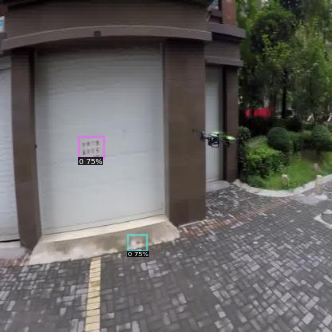

Time: 0.25612854957580566


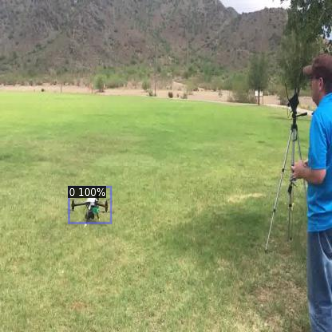

Time: 0.2566795349121094


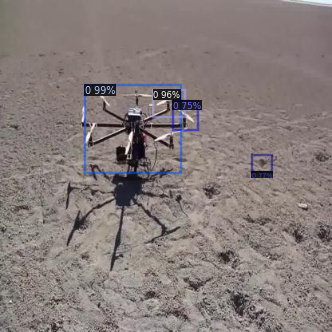

Time: 0.2559819221496582


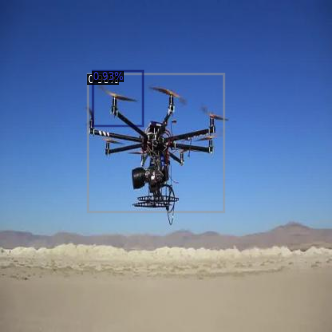

Time: 0.26085543632507324


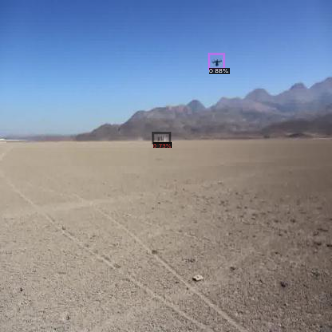

Time: 0.2582554817199707


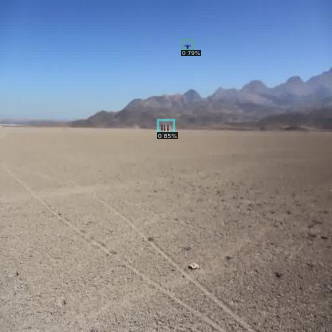

Time: 0.2547447681427002


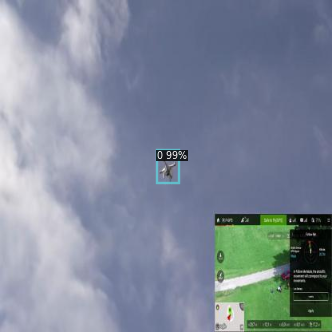

Time: 0.2549746036529541


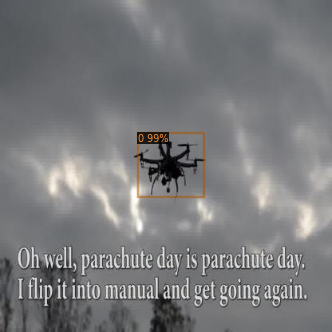

Time: 0.2573096752166748


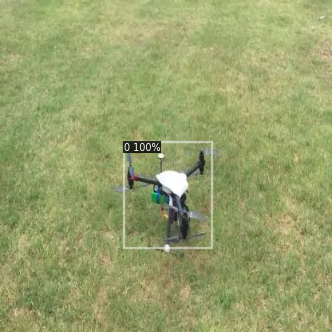

Time: 0.2569882869720459


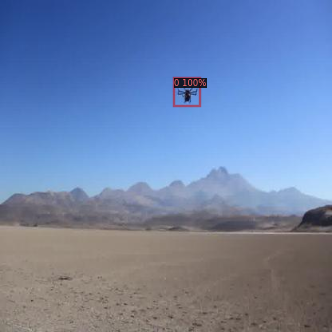

Time: 0.2585017681121826


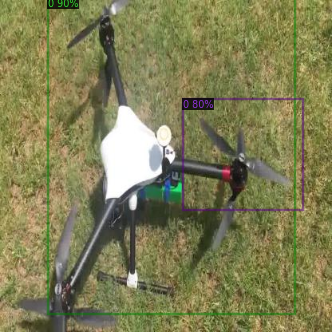

Time: 0.25916194915771484


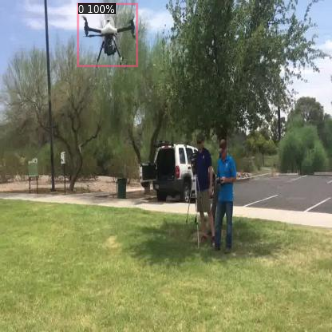

Time: 0.25588345527648926


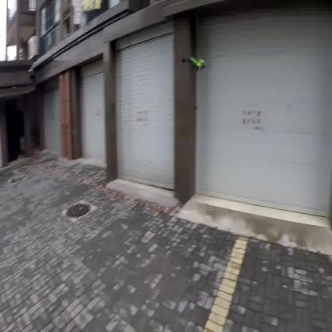

Time: 0.2561683654785156


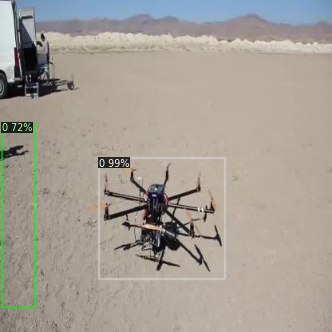

Time: 0.2584702968597412


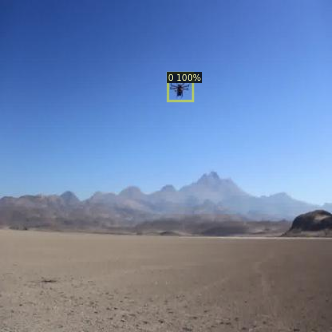

Time: 0.26233935356140137


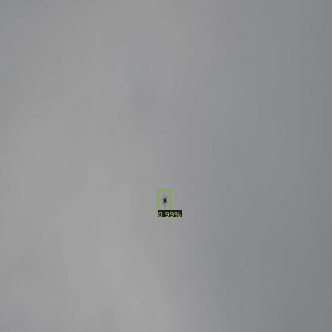

Time: 0.25806760787963867


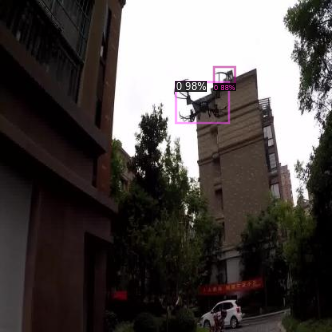

Time: 0.2607877254486084


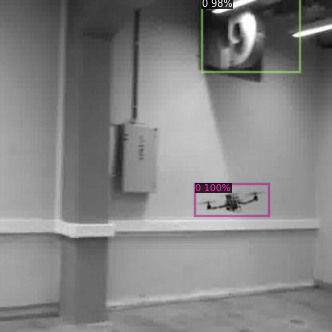

Time: 0.2584967613220215


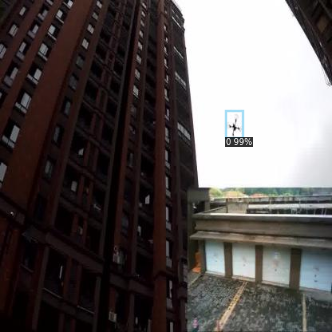

Time: 0.25670838356018066


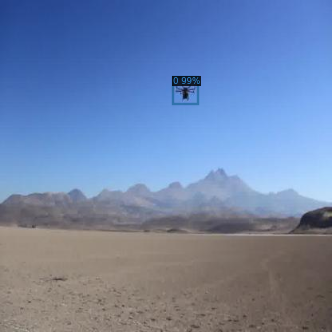

Time: 0.2569267749786377


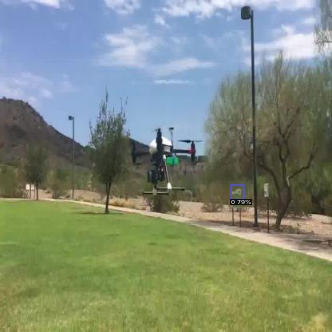

Time: 0.255690336227417


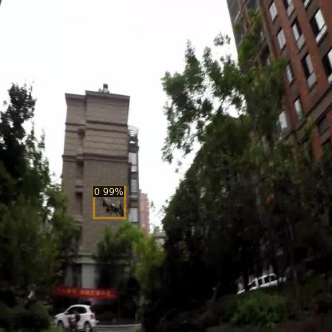

Time: 0.254605770111084


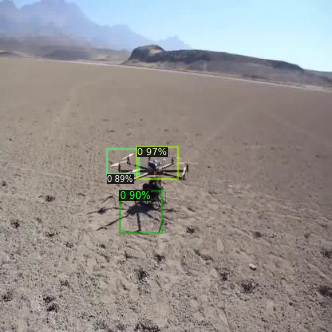

KeyboardInterrupt: ignored

In [ ]:
from detectron2.utils.visualizer import ColorMode
import glob
from time import time

for i,imageName in enumerate(glob.glob('/content/test/*jpg')):
  im = cv2.imread(imageName)
  t1 = time()
  outputs = predictor(im)
  print(f"Time: {time()-t1}")
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])
  if(i > 100):
      break 

### Target dataset

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("target_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("target_dataset_test")

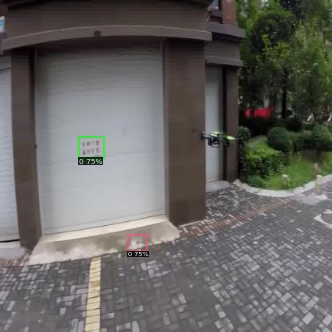

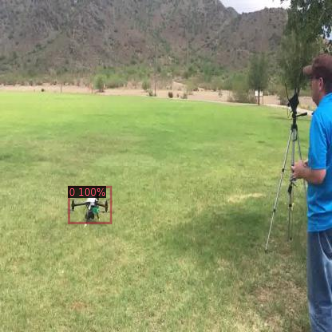

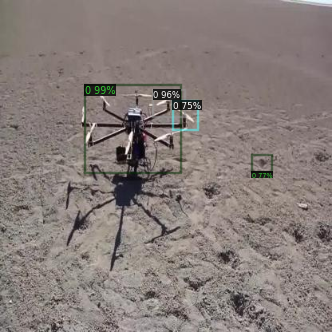

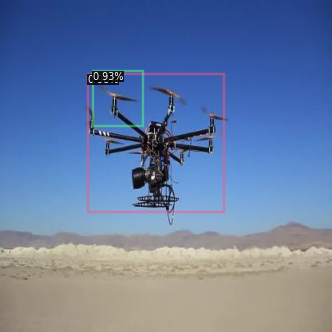

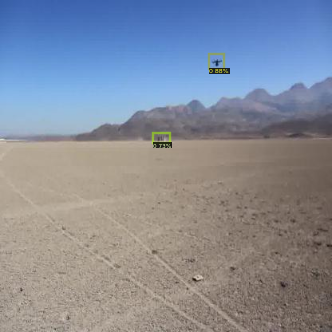

...

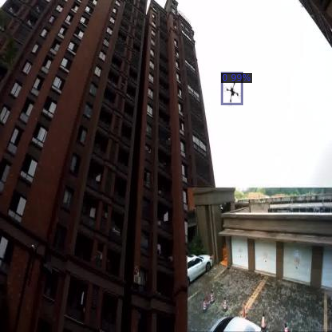

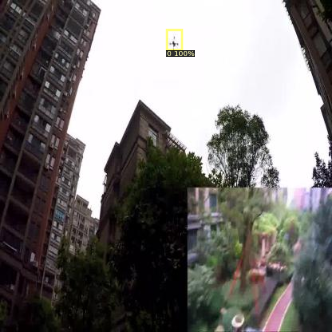

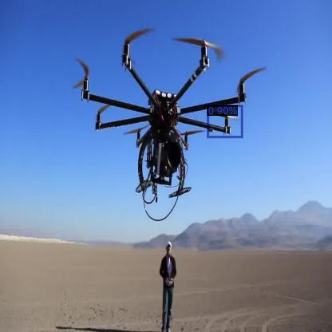

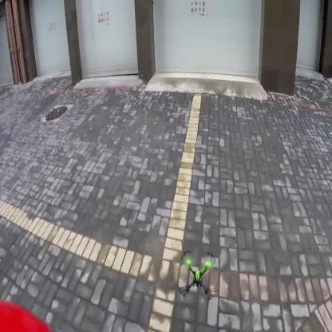

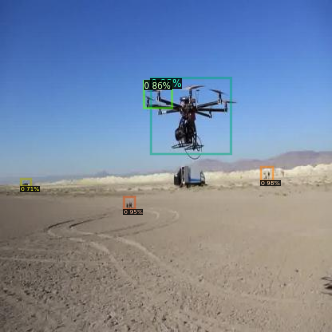

In [ ]:
from detectron2.utils.visualizer import ColorMode
import glob

for i,imageName in enumerate(glob.glob('/content/data2/test/*jpg')):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])
  if(i > 100):
      break 


## Save the model and download it

In [ ]:
!zip -r /content/output_faster_rcnn_R_101_C4_3x.zip /content/output
from google.colab import files
files.download("/content/output_faster_rcnn_R_101_C4_3x.zip")

updating: content/output/ (stored 0%)
updating: content/output/coco_instances_results.json (deflated 70%)
updating: content/output/model_final.pth (deflated 7%)
updating: content/output/instances_predictions.pth (deflated 57%)
updating: content/output/events.out.tfevents.1633489607.3d558072b73e.77.0 (deflated 73%)
updating: content/output/metrics.json (deflated 80%)
updating: content/output/last_checkpoint (stored 0%)
  adding: content/output/events.out.tfevents.1633493063.3d558072b73e.77.1 (deflated 72%)
  adding: content/output/events.out.tfevents.1633494475.3d558072b73e.77.2 (deflated 73%)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>